In [1]:
import sys
!{sys.executable} -m pip install torchscan torchsummary

In [3]:
import argparse
import os
import random
import math

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as vdatasets
import torchvision.transforms as T
import torchvision.utils as vutils

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
import pandas as pd

from IPython.display import HTML

from torchscan import summary
# from torchsummary import summary

import tqdm
from tqdm.notebook import tqdm as tqdm_nb

import warnings
warnings.filterwarnings("ignore")

# os.environ['TORCH_HOME'] = '~/torch_home'
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

manualSeed = 999
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


# Source code

based on [PyTorch DCGAN Tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)

In [4]:
# Number of workers for dataloader
workers = 16

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 20

# Nubmer of loop to train ciritic
n_critics = 5

# Learning rate for optimizers
lr = 0.0001

# Weight Clipping Limit
weight_cliping_limit = 0.01

# lambda for Gradient penalty
lambda_gp = 10

# Beta1 hyperparam for Adam optimizers
beta1 = 0.0
beta2 = 0.9

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

# CelebA Dataset

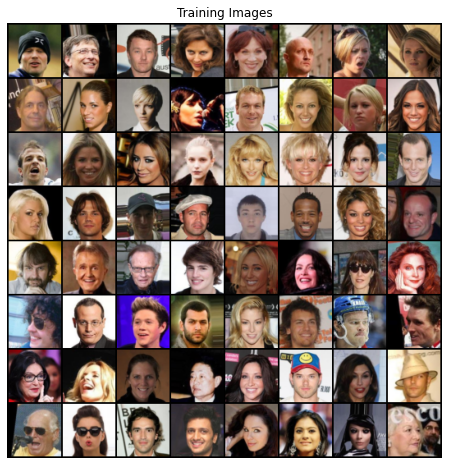

In [5]:
dataset = vdatasets.ImageFolder(root='./CelebA/img_align_celeba/',
                                transform=T.Compose([
                                    T.Resize(image_size),
                                    T.CenterCrop(image_size),
                                    T.ToTensor(),
                                    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

device = torch.device('cuda' if (torch.cuda.is_available() and ngpu > 0) else 'cpu')

one_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(one_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Utils

In [6]:
# custom weights initialization called on netG and netD
def weights_init(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [7]:
class SaveCheckpoint:
    def __init__(self, path = None):
        self.loss = np.inf
        self.path = path or os.path.join('.')
    
    def update(self, model, loss):
        if self.loss > loss:
            self.loss = loss
            self.save(model)

    def save(self, model, name):
        if isinstance(model, nn.Module):
            model = [model]
            name = [name]
        for m, n in zip(model, name):
            torch.save(m.state_dict(), '{}/{}.pth'.format(self.path, n))

# Define Models

In [8]:
# Generator Code

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.model = nn.Sequential(
            nn.Linear(nz, 128),
            nn.BatchNorm1d(128, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(128, 256),
            nn.BatchNorm1d(256, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(256, 512),
            nn.BatchNorm1d(512, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(512, 1024),
            nn.BatchNorm1d(1024, 0.8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Linear(1024, nc * image_size * image_size),
            nn.Tanh()
        )

    def forward(self, z):
        img = self.model(z)
        img = img.view(img.shape[0], nc, image_size, image_size)
        return img

In [9]:
# Create the generator
netG = Generator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
# netG.apply(weights_init)

# Print the model
# summary(netG, (batch_size, nz))
print(netG)

Generator(
  (model): Sequential(
    (0): Linear(in_features=100, out_features=128, bias=True)
    (1): BatchNorm1d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): Linear(in_features=128, out_features=256, bias=True)
    (4): BatchNorm1d(256, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): Linear(in_features=256, out_features=512, bias=True)
    (7): BatchNorm1d(512, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): Linear(in_features=512, out_features=1024, bias=True)
    (10): BatchNorm1d(1024, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): Linear(in_features=1024, out_features=12288, bias=True)
    (13): Tanh()
  )
)


In [10]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.model = nn.Sequential(
            nn.Linear(nc * image_size * image_size, 512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(256, 1),
        )

    def forward(self, img):
        img_flat = img.view(img.shape[0], -1)
        validity = self.model(img_flat)
        return validity


In [11]:
# Create the Discriminator
netD = Discriminator().to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
# netD.apply(weights_init)

# Print the model
# summary(netD, (3, 64, 64))
print(netD)

Discriminator(
  (model): Sequential(
    (0): Linear(in_features=12288, out_features=512, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Linear(in_features=512, out_features=256, bias=True)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)


In [12]:
# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, device=device)

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))

# optimizerD = optim.RMSprop(netD.parameters(), lr=lr)
# optimizerG = optim.RMSprop(netG.parameters(), lr=lr)

# Gradient Penalty

In [13]:
from torch import autograd
from torch.autograd import Variable

Tensor = torch.cuda.FloatTensor

lambda_gp = 10

In [14]:
from torch import autograd

def compute_gradient_penalty(D, real_samples, fake_samples):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and fake samples
    alpha = torch.randn(real_samples.size(0), 1, 1, 1, device=device)
    # Get random interpolation between real and fake samples
    interpolates = (alpha * real_samples + ((1 - alpha) * fake_samples)).requires_grad_(True)
    d_interpolates = D(interpolates)
    fake = torch.ones(real_samples.shape[0], 1, device=device)
    # Get gradient w.r.t. interpolates
    gradients = autograd.grad(
        outputs=d_interpolates,
        inputs=interpolates,
        grad_outputs=fake,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean()
    return gradient_penalty

# Train Loop

In [15]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []

total_steps = num_epochs * len(dataloader)
fig_save_interval = total_steps // 30   # animation can contain max 36 images

pbar = tqdm_nb()
piter = 0

checkpoint = SaveCheckpoint()

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    epoch_steps = len(dataloader)
    pbar.reset(total=epoch_steps)
    for i, data in enumerate(dataloader, 0):
        pbar.update()
        piter += 1
        ################################################################
        # (1) Update D network
        ################################################################
        netD.zero_grad()
        
        real_imgs = data[0].float().to(device)
        b_size = data[0].shape[0]
        noise = torch.randn(b_size, nz, device=device)

        # Generate a batch of images
        fake_imgs = netG(noise)

        real_validity = netD(real_imgs)
        fake_validity = netD(fake_imgs)
        # Gradient penalty
        gp = compute_gradient_penalty(netD, real_imgs.data, fake_imgs.data)
        
        # Adversarial loss
        errD = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gp
        errD.backward()
        optimizerD.step()
        
        # Train Generator for every 5 steps
        if i % n_critics == 0:
            ################################################################
            # (2) Update G network
            ################################################################
            netG.zero_grad()

            gen_img = netG(noise)
            errG = -torch.mean(netD(gen_img))
            errG.backward()
            optimizerG.step()

            # Output training stats
            desc = '[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f' \
                    % (epoch+1, num_epochs, i, epoch_steps, errD.item(), errG.item())
            pbar.set_description(desc)

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (piter - 1) % fig_save_interval == 0:
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append((epoch+1, i, vutils.make_grid(fake, padding=2, normalize=True)))
            print(desc)

pbar.refresh()

checkpoint.save([netG, netD], ['CelebA_netG', 'CelebA_netD'])

0it [00:00, ?it/s]

Starting Training Loop...
[1/20][0/3166] Loss_D: 8.0652 Loss_G: -0.0423
[1/20][2110/3166] Loss_D: -25.5339 Loss_G: 3.7581
[2/20][1050/3166] Loss_D: -20.3372 Loss_G: 6.2738
[2/20][3160/3166] Loss_D: -21.3316 Loss_G: 10.4075
[3/20][2105/3166] Loss_D: -14.4108 Loss_G: 8.1057
[4/20][1050/3166] Loss_D: -19.2479 Loss_G: 13.7364
[4/20][3160/3166] Loss_D: -17.2144 Loss_G: 12.9029
[5/20][2105/3166] Loss_D: -14.7974 Loss_G: 13.8807
[6/20][1050/3166] Loss_D: -10.8973 Loss_G: 15.3017
[6/20][3160/3166] Loss_D: -13.8965 Loss_G: 14.6336
[7/20][2100/3166] Loss_D: -11.2485 Loss_G: 13.1214
[8/20][1045/3166] Loss_D: -9.3552 Loss_G: 11.5852
[8/20][3155/3166] Loss_D: -9.9743 Loss_G: 8.6943
[9/20][2100/3166] Loss_D: -9.0787 Loss_G: 8.4517
[10/20][1045/3166] Loss_D: -10.0726 Loss_G: 2.3452
[10/20][3155/3166] Loss_D: -7.2279 Loss_G: 8.6243
[11/20][2100/3166] Loss_D: -7.8932 Loss_G: 6.6124
[12/20][1040/3166] Loss_D: -8.5474 Loss_G: 7.9014
[12/20][3150/3166] Loss_D: -7.3449 Loss_G: 7.7835
[13/20][2095/3166] Los

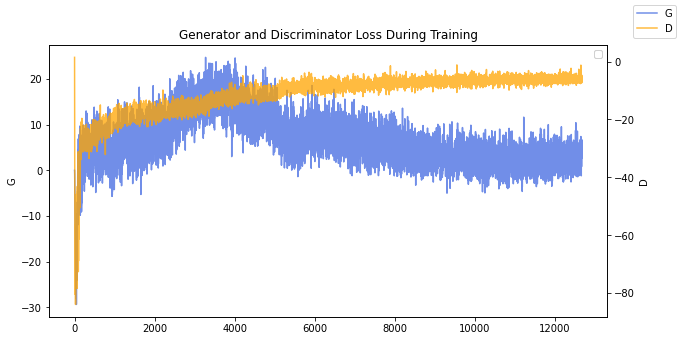

In [16]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
df = pd.DataFrame({'G': G_losses[1:], 'D': D_losses[1:]})
ax1 = sns.lineplot(data=df, x=df.index, y='G', label='G', color='royalblue', alpha=.75)
ax2 = ax1.twinx()
sns.lineplot(data=df, x=df.index, y='D', label='D', color='orange', alpha=.75, ax=ax2)
for ax in [ax1, ax2]:
#     ax.set_ylim(bottom=0.)
    ax.legend([])
ax1.figure.legend()
plt.show()

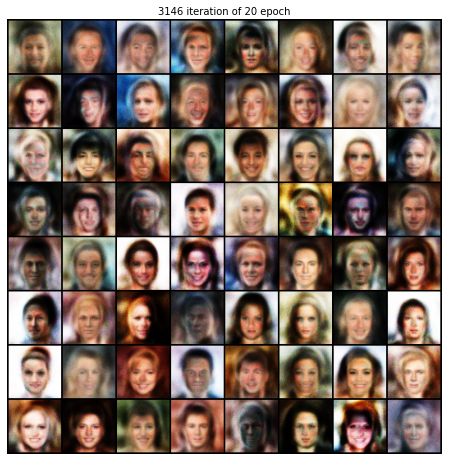

In [17]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111)
plt.axis('off')
imgs = [[
    plt.imshow(np.transpose(img, (1,2,0)), animated=True),
    plt.text(0.5, 1.01, f'{step} iteration of {epoch} epoch', horizontalalignment='center', transform=ax.transAxes),
] for epoch, step, img in img_list]

ani = animation.ArtistAnimation(fig, imgs, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

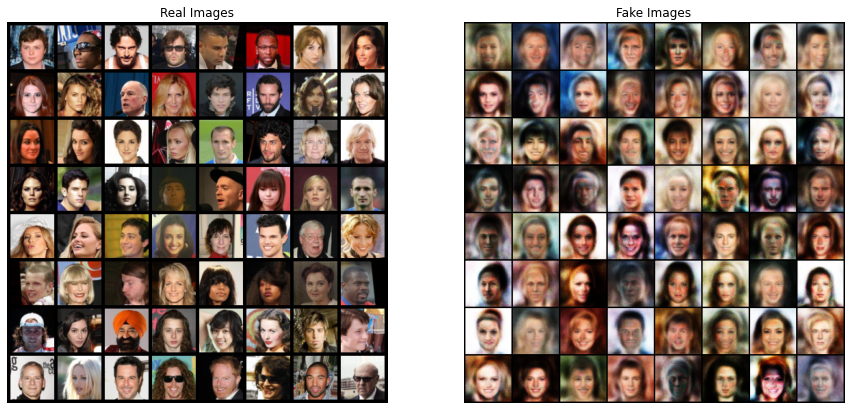

In [18]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15, 15))

plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1][-1],(1,2,0)))
plt.show()

# Interpolation

In [19]:
def interpolate_points(p1, p2, n_steps=10):
    ratios = np.linspace(0, 1, num=n_steps)
    vs = []
    for ratio in ratios:
        v = (1.0 - ratio) * p1 + ratio * p2
        vs.append(v)
    return torch.stack(vs)

In [21]:
n1 = torch.randn(5, nz, device=device)
n2 = torch.randn(5, nz, device=device)
fake = []
for i in range(5):
    point = interpolate_points(n1[i], n2[i]).to(device)
    fake.append(netG(point))
fake = torch.vstack(fake).cpu()

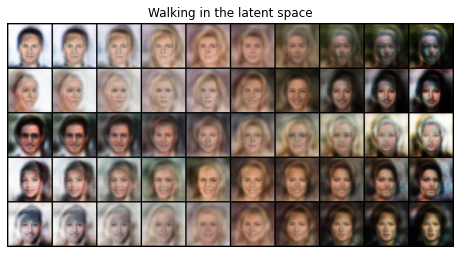

In [22]:
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Walking in the latent space')
plt.imshow(np.transpose(vutils.make_grid(fake, nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
plt.show()

Can not expected features before seeing result from noise, so checking average is meaningless here

In [ ]:
# # average list of latent space vectors
# def average_points(points, ix):
#     return np.mean(points[ix], axis=0)

In [ ]:
# f_smiling = [22, 24, 29, 30, 59]
# f_neutral = [7, 9, 13, 18, 60]
# f_short = [8, 26, 37, 41, 45]
# f_long = [20, 25, 28, 35, 48]

In [ ]:
# noise_cpu = fixed_noise.detach().cpu().numpy()
# avg_smiling = average_points(noise_cpu, f_smiling)
# avg_neutral = average_points(noise_cpu, f_neutral)
# avg_short = average_points(noise_cpu, f_short)
# avg_long = average_points(noise_cpu, f_long)
# avg_imgs = torch.from_numpy(np.stack([avg_smiling, avg_neutral, avg_short, avg_long])).to(device)

In [ ]:
# plt.figure(figsize=(8, 8))
# plt.axis('off')
# plt.title('Average points (Smile / Neutral / Short / Long)')
# plt.imshow(np.transpose(vutils.make_grid(netG(avg_imgs), nrow=6, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

In [ ]:
# short_to_long = interpolate_points(torch.from_numpy(avg_short), torch.from_numpy(avg_long)).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Short to long hair')
# plt.imshow(np.transpose(vutils.make_grid(netG(short_to_long), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

# Vector Arithmetic

In [ ]:
# smiling_short = (fixed_noise[f_smiling] - fixed_noise[f_neutral] + fixed_noise[f_short]).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Smiling - Neutral + Short hair')
# plt.imshow(np.transpose(vutils.make_grid(netG(smiling_short), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

In [ ]:
# neutral_short = (fixed_noise[f_neutral] - fixed_noise[f_smiling] + fixed_noise[f_short]).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Neutral - Smiling + Short hair')
# plt.imshow(np.transpose(vutils.make_grid(netG(neutral_short), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

In [ ]:
# long_smiling = (fixed_noise[f_long] - fixed_noise[f_short] + fixed_noise[f_smiling]).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Long hair - Short hair + Smiling')
# plt.imshow(np.transpose(vutils.make_grid(netG(long_smiling), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

In [ ]:
# short_smiling = (fixed_noise[f_short] - fixed_noise[f_long] + fixed_noise[f_smiling]).to(device)

# plt.figure(figsize=(12, 2))
# plt.axis('off')
# plt.title('Short hair - Long hair + Smiling')
# plt.imshow(np.transpose(vutils.make_grid(netG(short_smiling), nrow=10, padding=2, normalize=True).cpu(), (1,2,0)))
# plt.show()

# LSUN Dataset

Overwrite hyper parameters

In [23]:
batch_size = 64

num_epochs = 10

# lr = 0.0002

n_critics = 5

Remove all used variables for previous model and to let them free

In [24]:
import gc

del dataset
del dataloader

del pbar
del img_list

del netG
del netD

del optimizerD
del optimizerG

del errD
del errG

del fixed_noise

gc.collect()

torch.cuda.empty_cache()

Declare and assign new instance to ready to train for LSUN

In [25]:
netG = Generator().to(device)
netG.apply(weights_init)

netD = Discriminator().to(device)
netD.apply(weights_init)

Discriminator(
  (model): Sequential(
    (0): Linear(in_features=12288, out_features=512, bias=True)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Linear(in_features=512, out_features=256, bias=True)
    (3): LeakyReLU(negative_slope=0.2, inplace=True)
    (4): Linear(in_features=256, out_features=1, bias=True)
  )
)

In [30]:
fixed_noise = torch.randn(64, nz, device=device)

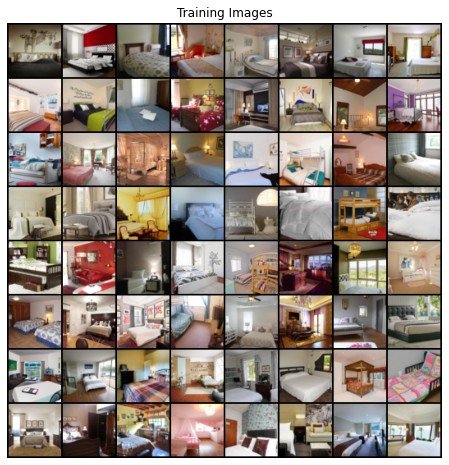

In [31]:
dataset = vdatasets.ImageFolder(root='./LSUN/data0/lsun/bedroom',
                                transform=T.Compose([
                                    T.Resize(image_size),
                                    T.CenterCrop(image_size),
                                    T.ToTensor(),
                                    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                                ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

one_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(one_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [32]:
# step_size = len(dataloader)

# optimizerD = torch.optim.SGD(netD.parameters(), lr=1e-5, momentum=0.5)
# optimizerG = torch.optim.SGD(netG.parameters(), lr=1e-5, momentum=0.9)
# schedulerD = torch.optim.lr_scheduler.CyclicLR(optimizerD, base_lr=1e-5, max_lr=0.0005,
#                                                step_size_up=step_size, gamma=0.75, mode='triangular2')
# schedulerG = torch.optim.lr_scheduler.CyclicLR(optimizerG, base_lr=1e-5, max_lr=0.0005,
#                                                step_size_up=step_size, gamma=0.75, mode='triangular2')

# optimizerD = optim.RMSprop(netD.parameters(), lr = 1e-4)
# optimizerG = optim.RMSprop(netG.parameters(), lr = 1e-4)

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, beta2))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, beta2))

# Train Loop for LSUN

In [33]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []

total_steps = num_epochs * len(dataloader)
fig_save_interval = total_steps // 30   # animation can contain max 36 images

pbar = tqdm_nb()
piter = 0

checkpoint = SaveCheckpoint()

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    epoch_steps = len(dataloader)
    pbar.reset(total=epoch_steps)
    for i, data in enumerate(dataloader, 0):
        pbar.update()
        piter += 1
        ################################################################
        # (1) Update D network
        ################################################################
        netD.zero_grad()
        
        real_imgs = data[0].float().to(device)
        b_size = data[0].shape[0]
        noise = torch.randn(b_size, nz, device=device)

        # Generate a batch of images
        fake_imgs = netG(noise)

        real_validity = netD(real_imgs)
        fake_validity = netD(fake_imgs)
        # Gradient penalty
        gp = compute_gradient_penalty(netD, real_imgs.data, fake_imgs.data)
        
        # Adversarial loss
        errD = -torch.mean(real_validity) + torch.mean(fake_validity) + lambda_gp * gp
        errD.backward()
        optimizerD.step()
        
        # Train Generator for every 5 steps
        if i % n_critics == 0:
            ################################################################
            # (2) Update G network
            ################################################################
            netG.zero_grad()

            gen_img = netG(noise)
            errG = -torch.mean(netD(gen_img))
            errG.backward()
            optimizerG.step()

            # Output training stats
            desc = '[%d/%d][%d/%d] Loss_D: %.4f Loss_G: %.4f' \
                    % (epoch+1, num_epochs, i, epoch_steps, errD.item(), errG.item())
            pbar.set_description(desc)

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (piter - 1) % fig_save_interval == 0:
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append((epoch+1, i, vutils.make_grid(fake, padding=2, normalize=True)))
            print(desc)

pbar.refresh()

checkpoint.save([netG, netD], ['LSUN_netG', 'LSUN_netD'])

0it [00:00, ?it/s]

Starting Training Loop...
[1/10][0/4737] Loss_D: 7.5075 Loss_G: -0.0202
[1/10][1575/4737] Loss_D: -26.9364 Loss_G: 2.6398
[1/10][3155/4737] Loss_D: -23.6099 Loss_G: 2.5858
[2/10][0/4737] Loss_D: -19.8353 Loss_G: 2.0079
[2/10][1575/4737] Loss_D: -21.9351 Loss_G: 2.2241
[2/10][3155/4737] Loss_D: -18.1668 Loss_G: 1.2133
[3/10][0/4737] Loss_D: -17.3515 Loss_G: -4.7550
[3/10][1575/4737] Loss_D: -15.9919 Loss_G: -1.6192
[3/10][3155/4737] Loss_D: -15.8162 Loss_G: 3.9916
[4/10][0/4737] Loss_D: -12.7206 Loss_G: 0.4141
[4/10][1575/4737] Loss_D: -14.2197 Loss_G: 0.3903
[4/10][3155/4737] Loss_D: -12.8171 Loss_G: 0.4171
[5/10][0/4737] Loss_D: -11.4466 Loss_G: -2.1882
[5/10][1575/4737] Loss_D: -13.9197 Loss_G: 3.3563
[5/10][3155/4737] Loss_D: -14.8131 Loss_G: 8.0900
[6/10][0/4737] Loss_D: -13.9627 Loss_G: 7.1557
[6/10][1575/4737] Loss_D: -13.5211 Loss_G: 7.7934
[6/10][3155/4737] Loss_D: -12.6696 Loss_G: 9.7156
[7/10][0/4737] Loss_D: -9.3764 Loss_G: 7.3846
[7/10][1575/4737] Loss_D: -9.8072 Loss_G: 6.

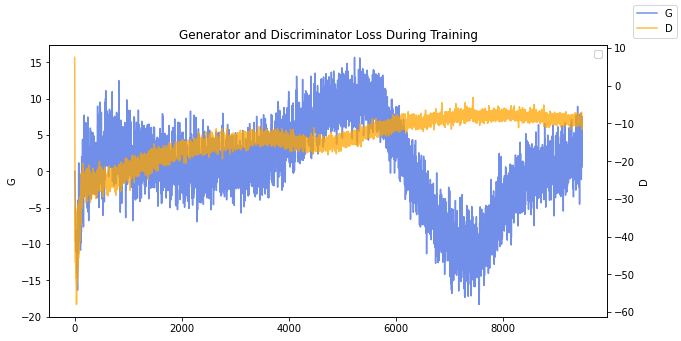

In [34]:
plt.figure(figsize=(10, 5))
plt.title("Generator and Discriminator Loss During Training")
df = pd.DataFrame({'G': G_losses, 'D': D_losses})
ax1 = sns.lineplot(data=df, x=df.index, y='G', label='G', color='royalblue', alpha=.75)
ax2 = ax1.twinx()
sns.lineplot(data=df, x=df.index, y='D', label='D', color='orange', alpha=.75, ax=ax2)
for ax in [ax1, ax2]:
#     ax.set_ylim(bottom=0.)
    ax.legend([])
ax1.figure.legend()
plt.show()

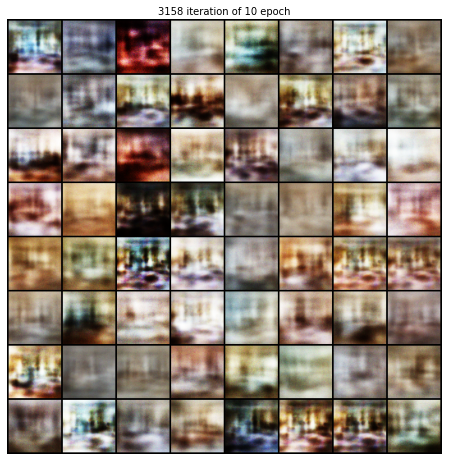

In [35]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111)
plt.axis('off')
imgs = [[
    plt.imshow(np.transpose(img, (1,2,0)), animated=True),
    plt.text(0.5, 1.01, f'{step} iteration of {epoch} epoch', horizontalalignment='center', transform=ax.transAxes),
] for epoch, step, img in img_list]

ani = animation.ArtistAnimation(fig, imgs, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

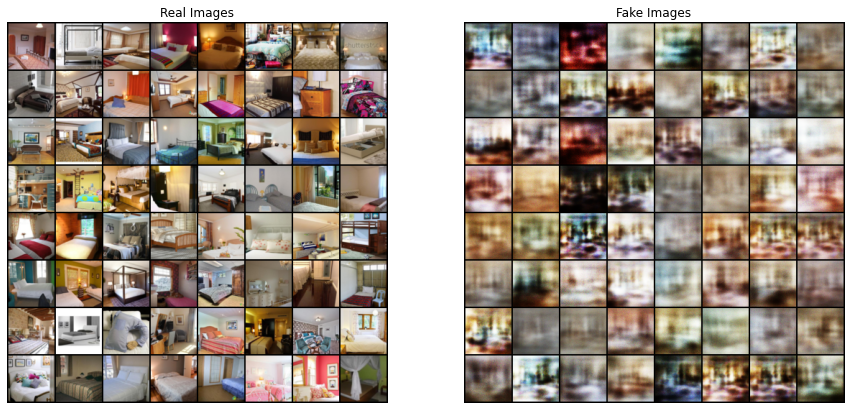

In [36]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15, 15))

plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1][-1],(1,2,0)))
plt.show()